In [97]:
#Part1
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import folium

In [98]:
#Part2
# Вказуємо шлях до CSV-файлу з даними про злочини
dataset_path = './Data/Police_Department_Incident_Reports__Historical_2003_to_May_2018_20251002.csv'

# Завантажуємо CSV у pandas DataFrame
SF = pd.read_csv(dataset_path)


In [99]:
# Читаємо перші 5 рядків файлу, не використовуючи Linux-команди
with open(dataset_path, 'r', encoding='utf-8') as file:
    for i in range(5):
        print(file.readline().strip())


"PdId","IncidntNum","Incident Code","Category","Descript","DayOfWeek","Date","Time","PdDistrict","Resolution","Address","X","Y","location","data_loaded_at"
"16020415607021","160204156","07021","VEHICLE THEFT","STOLEN AUTOMOBILE","Thursday","03/03/2016","19:30","TARAVAL","NONE","100 Block of BEPLER ST","-122.46354501682","37.70796836451","POINT (-122.463545017 37.707968365)","2025/06/20 12:17:56 PM"
"13011910904134","130119109","04134","ASSAULT","BATTERY","Sunday","02/10/2013","18:09","MISSION","NONE","900 Block of DOLORES ST","-122.42523670719","37.75422219068","POINT (-122.425236707 37.754222191)","2025/06/20 12:17:56 PM"
"6102672004134","061026720","04134","ASSAULT","BATTERY","Monday","09/25/2006","22:15","NORTHERN","NONE","400 Block of FULTON ST","-122.42583948035","37.778486375","POINT (-122.42583948 37.778486375)","2025/06/20 12:17:56 PM"
"11049313327195","110493133","27195","TRESPASS","TRESPASSING","Sunday","06/19/2011","13:06","TARAVAL","NONE","100 Block of APTOS AV","-122.46675

In [100]:
# Налаштовуємо відображення до 10 рядків і показуємо DataFrame
pd.set_option('display.max_rows', 10)
SF


,PdId,IncidntNum,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,Address,X,Y,location,data_loaded_at
0,16020415607021,160204156,7021,VEHICLE THEFT,STOLEN AUTOMOBILE,Thursday,03/03/2016,19:30,TARAVAL,NONE,100 Block of BEPLER ST,-122.463545,37.707968,POINT (-122.463545017 37.707968365),2025/06/20 12:17:56 PM
1,13011910904134,130119109,4134,ASSAULT,BATTERY,Sunday,02/10/2013,18:09,MISSION,NONE,900 Block of DOLORES ST,-122.425237,37.754222,POINT (-122.425236707 37.754222191),2025/06/20 12:17:56 PM
2,6102672004134,61026720,4134,ASSAULT,BATTERY,Monday,09/25/2006,22:15,NORTHERN,NONE,400 Block of FULTON ST,-122.425839,37.778486,POINT (-122.42583948 37.778486375),2025/06/20 12:17:56 PM
3,11049313327195,110493133,27195,TRESPASS,TRESPASSING,Sunday,06/19/2011,13:06,TARAVAL,NONE,100 Block of APTOS AV,-122.466758,37.729185,POINT (-122.466758005 37.72918458),2025/06/20 12:17:56 PM
4,8074906804134,80749068,4134,ASSAULT,BATTERY,Friday,05/23/2008,12:10,NORTHERN,NONE,300 Block of FELL ST,-122.423582,37.775904,POINT (-122.423581857 37.775904267),2025/06/20 12:17:56 PM
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2071731,5076179106374,50761791,6374,LARCENY/THEFT,GRAND THEFT OF PROPERTY,Saturday,07/09/2005,22:30,NORTHERN,NONE,0 Block of TOLEDO WY,-122.438546,37.801285,POINT (-122.438545759 37.801284562),2025/06/20 12:17:56 PM
2071732,9101956365015,91019563,65015,OTHER OFFENSES,TRAFFIC VIOLATION,Thursday,10/01/2009,23:52,BAYVIEW,"ARREST, BOOKED",3RD ST / KIRKWOOD AV,-122.389588,37.737957,POINT (-122.389588165 37.737957265),2025/06/20 12:17:56 PM
2071733,10088749904012,100887499,4012,ASSAULT,AGGRAVATED ASSAULT WITH A KNIFE,Friday,09/24/2010,11:45,SOUTHERN,"ARREST, BOOKED",800 Block of BRYANT ST,-122.403405,37.775421,POINT (-122.403404791 37.775420707),2025/06/20 12:17:56 PM
2071734,5006491526200,50064915,26200,OTHER OFFENSES,MISCELLANEOUS STATE FELONY,Sunday,01/02/2005,10:00,SOUTHERN,NONE,800 Block of BRYANT ST,-122.403405,37.775421,POINT (-122.403404791 37.775420707),2025/06/20 12:17:56 PM


In [101]:
# Перелік усіх назв колонок (змінних) у наборі даних
SF.columns

Index(['PdId', 'IncidntNum', 'Incident Code', 'Category', 'Descript',
       'DayOfWeek', 'Date', 'Time', 'PdDistrict', 'Resolution', 'Address', 'X',
       'Y', 'location', 'data_loaded_at'],
      dtype='object')

In [102]:
# Визначаємо кількість рядків у наборі даних
len(SF)


2071736

In [103]:
#Part3
# Додаємо новий стовпець 'Month', витягуючи перші два символи з 'Date' і перетворюючи їх на число
SF['Month'] = SF['Date'].apply(lambda row: int(row[0:2]))

# Додаємо новий стовпець 'Day', витягуючи символи з 3 по 5 (день)
SF['Day'] = SF['Date'].apply(lambda row: int(row[3:5]))


In [104]:
# Виводимо перші 2 значення для перевірки
print(SF['Month'][0:2])
print(SF['Day'][0:2])


0    3
1    2
Name: Month, dtype: int64
0     3
1    10
Name: Day, dtype: int64


In [105]:
# Перевіряємо тип елементів у колонці 'Month' (має бути int)
print(type(SF['Month'][0]))


<class 'numpy.int64'>


In [106]:
# Видаляємо колонку з великою кількістю пропусків (NaN)
del SF['IncidntNum']


In [107]:
# Видаляємо колонку 'location' за допомогою drop (axis=1 означає — працюємо зі стовпцями)
SF.drop('location', axis=1, inplace=True)


In [108]:
# Виводимо список всіх колонок після очищення
SF.columns

Index(['PdId', 'Incident Code', 'Category', 'Descript', 'DayOfWeek', 'Date',
       'Time', 'PdDistrict', 'Resolution', 'Address', 'X', 'Y',
       'data_loaded_at', 'Month', 'Day'],
      dtype='object')

In [109]:
#Part4
# Підраховуємо кількість випадків для кожного виду злочину
CountCategory = SF['Category'].value_counts()
# Виводимо результат
print(CountCategory)

Category
LARCENY/THEFT                 477975
OTHER OFFENSES                301874
NON-CRIMINAL                  179139
ASSAULT                       167042
VEHICLE THEFT                 126228
                               ...  
EXTORTION                        729
GAMBLING                         343
PORNOGRAPHY/OBSCENE MAT           57
SEX OFFENSES, NON FORCIBLE        43
TREA                              14
Name: count, Length: 37, dtype: int64


In [110]:
# Підрахунок категорій злочинів за зростанням
SF['Category'].value_counts(ascending=True)
#Найбільше було скоєно злочину LARCENY/THEFT:  477975


Category
TREA                              14
SEX OFFENSES, NON FORCIBLE        43
PORNOGRAPHY/OBSCENE MAT           57
GAMBLING                         343
EXTORTION                        729
                               ...  
VEHICLE THEFT                 126228
ASSAULT                       167042
NON-CRIMINAL                  179139
OTHER OFFENSES                301874
LARCENY/THEFT                 477975
Name: count, Length: 37, dtype: int64

In [111]:
# Підрахунок кількості злочинів у кожному районі
print(SF['PdDistrict'].value_counts(ascending=True))
# У PdDistrict було найбільше випадків зареєстрованих злочинів RICHMOND: 110133



PdDistrict
RICHMOND      110133
PARK          116296
TARAVAL       150970
INGLESIDE     176557
TENDERLOIN    180934
BAYVIEW       201989
CENTRAL       216646
NORTHERN      260013
MISSION       279744
SOUTHERN      378453
Name: count, dtype: int64


In [112]:
# Створюємо новий DataFrame лише з злочинами, скоєними в серпні
AugustCrimes = SF[SF['Month'] == 8]

# Відображаємо результат
AugustCrimes

#За серпень було скоєно 176408  злочинів

,PdId,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,Address,X,Y,data_loaded_at,Month,Day
13,10079624810120,10120,FRAUD,"FALSE PRETENSES, PETTY THEFT",Saturday,08/28/2010,11:00,INGLESIDE,NONE,SANTOS ST / GENEVA AV,-122.420084,37.708311,2025/06/20 12:17:56 PM,8,28
66,14064055826170,26170,OTHER OFFENSES,PROBATION VIOLATION,Friday,08/01/2014,22:44,MISSION,"ARREST, BOOKED",24TH ST / CHURCH ST,-122.427440,37.751705,2025/06/20 12:17:56 PM,8,1
124,16069070928150,28150,VANDALISM,"MALICIOUS MISCHIEF, VANDALISM",Friday,08/26/2016,07:00,CENTRAL,NONE,2300 Block of MASON ST,-122.413541,37.804910,2025/06/20 12:17:56 PM,8,26
169,16064737406153,6153,LARCENY/THEFT,GRAND THEFT FROM PERSON,Thursday,08/11/2016,09:52,NORTHERN,NONE,300 Block of HAYES ST,-122.422159,37.776931,2025/06/20 12:17:56 PM,8,11
183,14615499306374,6374,LARCENY/THEFT,GRAND THEFT OF PROPERTY,Saturday,08/02/2014,14:25,MISSION,NONE,24TH ST / MISSION ST,-122.418448,37.752239,2025/06/20 12:17:56 PM,8,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2071656,10077376365016,65016,OTHER OFFENSES,"DRIVERS LICENSE, SUSPENDED OR REVOKED",Monday,08/23/2010,08:53,MISSION,"ARREST, CITED",MISSION ST / 23RD ST,-122.418597,37.753838,2025/06/20 12:17:56 PM,8,23
2071671,4094321616621,16621,DRUG/NARCOTIC,POSSESSION OF BASE/ROCK COCAINE,Wednesday,08/18/2004,15:10,BAYVIEW,"ARREST, BOOKED",1000 Block of CONNECTICUT ST,-122.397202,37.753535,2025/06/20 12:17:56 PM,8,18
2071685,11612935206374,6374,LARCENY/THEFT,GRAND THEFT OF PROPERTY,Sunday,08/01/2010,00:01,NORTHERN,NONE,2500 Block of GREEN ST,-122.441095,37.795479,2025/06/20 12:17:56 PM,8,1
2071688,13614329106244,6244,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Thursday,08/01/2013,10:00,CENTRAL,NONE,400 Block of STOCKTON ST,-122.406978,37.789918,2025/06/20 12:17:56 PM,8,1


In [113]:
# Підмножина серпневих злочинів, які є BURGLARY
AugustCrimes = SF[SF['Month'] == 8]
AugustCrimesB = SF[SF['Category'] == 'BURGLARY']
len(AugustCrimesB)
#Було зареєстровано 91067 квартирних крадіжок у серпні

91067

In [114]:
# Створюємо новий DataFrame для дати 4 липня
Crime0704 = SF.query('Month == 7 and Day == 4')
Crime0704


,PdId,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,Address,X,Y,data_loaded_at,Month,Day
501,16054189526030,26030,ARSON,ARSON,Monday,07/04/2016,18:00,INGLESIDE,NONE,400 Block of CAYUGA AV,-122.434885,37.729557,2025/06/20 12:17:56 PM,7,4
1033,16054117406243,6243,LARCENY/THEFT,PETTY THEFT FROM LOCKED AUTO,Monday,07/04/2016,16:30,NORTHERN,NONE,1800 Block of GEARY BL,-122.433312,37.784530,2025/06/20 12:17:56 PM,7,4
1171,16054140330190,30190,OTHER OFFENSES,VIOLATION OF MUNICIPAL POLICE CODE,Monday,07/04/2016,18:10,CENTRAL,"ARREST, BOOKED",BEACH ST / LARKIN ST,-122.422199,37.806435,2025/06/20 12:17:56 PM,7,4
1433,16054736006154,6154,LARCENY/THEFT,GRAND THEFT FROM PERSON,Monday,07/04/2016,21:30,CENTRAL,NONE,300 Block of BATTERY ST,-122.400216,37.794803,2025/06/20 12:17:56 PM,7,4
2319,16054147565016,65016,OTHER OFFENSES,"DRIVERS LICENSE, SUSPENDED OR REVOKED",Monday,07/04/2016,18:50,TENDERLOIN,"ARREST, BOOKED",500 Block of ELLIS ST,-122.415436,37.784585,2025/06/20 12:17:56 PM,7,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2070107,9068111504134,4134,ASSAULT,BATTERY,Saturday,07/04/2009,16:35,MISSION,NONE,24TH ST / HARRISON ST,-122.411902,37.752628,2025/06/20 12:17:56 PM,7,4
2070195,10061379911012,11012,STOLEN PROPERTY,"STOLEN PROPERTY, POSSESSION WITH KNOWLEDGE, RE...",Sunday,07/04/2010,08:00,SOUTHERN,"ARREST, BOOKED",1100 Block of MARKET ST,-122.413564,37.779514,2025/06/20 12:17:56 PM,7,4
2070315,6070871104154,4154,ASSAULT,BATTERY OF A POLICE OFFICER,Tuesday,07/04/2006,19:49,BAYVIEW,"ARREST, BOOKED",0 Block of DAKOTA ST,-122.395513,37.753618,2025/06/20 12:17:56 PM,7,4
2071306,12052851019400,19400,SECONDARY CODES,GANG ACTIVITY,Wednesday,07/04/2012,19:50,TENDERLOIN,"ARREST, BOOKED",STOCKTON ST / OFARRELL ST,-122.406402,37.786614,2025/06/20 12:17:56 PM,7,4


In [115]:
# Виводимо всі назви колонок
SF.columns

Index(['PdId', 'Incident Code', 'Category', 'Descript', 'DayOfWeek', 'Date',
       'Time', 'PdDistrict', 'Resolution', 'Address', 'X', 'Y',
       'data_loaded_at', 'Month', 'Day'],
      dtype='object')

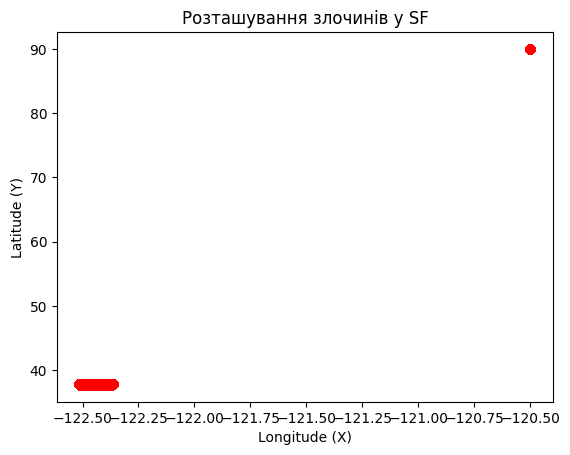

In [116]:
#Part5
# Побудова графіка точок за координатами X (довгота) та Y (широта)
# Червоні кола ('ro')
plt.plot(SF['X'], SF['Y'], 'ro')
plt.xlabel('Longitude (X)')
plt.ylabel('Latitude (Y)')
plt.title('Розташування злочинів у SF')
plt.show()


In [117]:
# Унікальні значення PdDistrict
SF['PdDistrict'] = SF['PdDistrict'].astype(str)
pd_districts = np.unique(SF['PdDistrict'])

# Створюємо словник, що зв'язує кожен район з числовим кодом
pd_districts_levels = dict(zip(pd_districts, range(len(pd_districts))))

# Перевірка словника
pd_districts_levels

{'BAYVIEW': 0,
 'CENTRAL': 1,
 'INGLESIDE': 2,
 'MISSION': 3,
 'NORTHERN': 4,
 'PARK': 5,
 'RICHMOND': 6,
 'SOUTHERN': 7,
 'TARAVAL': 8,
 'TENDERLOIN': 9,
 'nan': 10}

In [118]:
# Створюємо новий стовпець 'PdDistrictCode', який містить числовий код району
SF['PdDistrictCode'] = SF['PdDistrict'].apply(lambda row: pd_districts_levels[row])


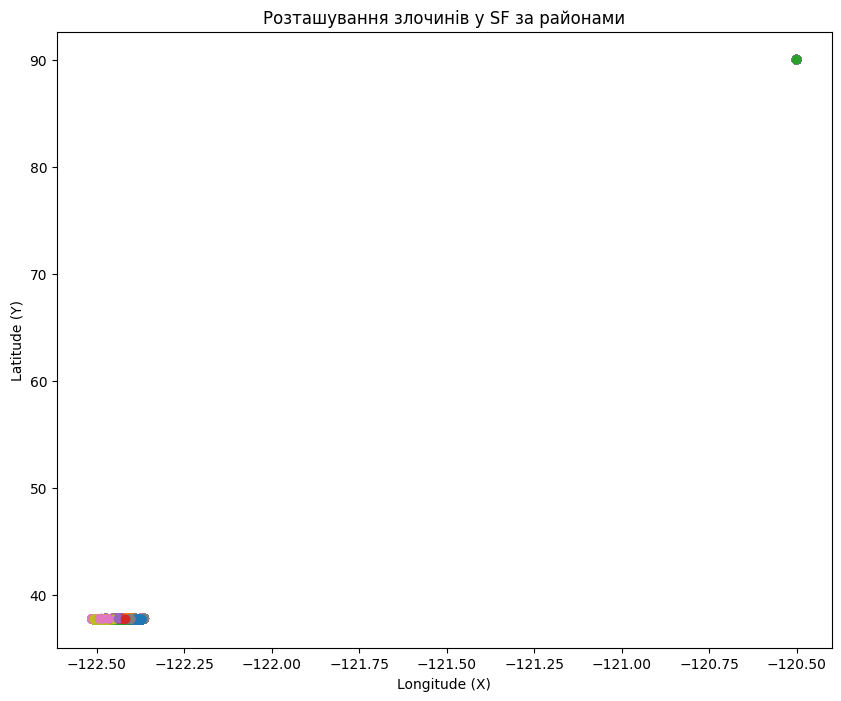

In [119]:
# Створюємо scatter plot, де колір залежить від PdDistrictCode
plt.figure(figsize=(10, 8))
plt.scatter(SF['X'], SF['Y'], c=SF['PdDistrictCode'], cmap='tab10')
plt.xlabel('Longitude (X)')
plt.ylabel('Latitude (Y)')
plt.title('Розташування злочинів у SF за районами')
plt.show()


In [120]:
# Імпорт кольорів з matplotlib
from matplotlib import colors

# Унікальні райони
districts = np.unique(SF['PdDistrict'])

# Перевірка доступних кольорів
print(list(colors.cnames.values())[0:len(districts)])


['#F0F8FF', '#FAEBD7', '#00FFFF', '#7FFFD4', '#F0FFFF', '#F5F5DC', '#FFE4C4', '#000000', '#FFEBCD', '#0000FF', '#8A2BE2']


In [121]:
# Імпорт кольорів з matplotlib
from matplotlib import colors

# Унікальні райони
districts = np.unique(SF['PdDistrict'])

# Перевірка доступних кольорів
print(list(colors.cnames.values())[0:len(districts)])


['#F0F8FF', '#FAEBD7', '#00FFFF', '#7FFFD4', '#F0FFFF', '#F5F5DC', '#FFE4C4', '#000000', '#FFEBCD', '#0000FF', '#8A2BE2']


In [122]:
# Призначаємо кожному району унікальний колір
color_dict = dict(zip(districts, list(colors.cnames.values())[0:-1:len(districts)]))

# Перевірка словника
color_dict


{'BAYVIEW': '#F0F8FF',
 'CENTRAL': '#A52A2A',
 'INGLESIDE': '#008B8B',
 'MISSION': '#E9967A',
 'NORTHERN': '#1E90FF',
 'PARK': '#ADFF2F',
 'RICHMOND': '#FFFACD',
 'SOUTHERN': '#87CEFA',
 'TARAVAL': '#0000CD',
 'TENDERLOIN': '#FFE4B5',
 'nan': '#AFEEEE'}

In [123]:
# Створюємо карту, центровану на середніх координатах
map_osm = folium.Map(location=[SF['Y'].mean(), SF['X'].mean()], zoom_start=12)

# Обмеження кількості точок для швидшої побудови
plotEvery = 50

# Створюємо список спостережень (Y, X, PdDistrict)
obs = list(zip(SF['Y'], SF['X'], SF['PdDistrict']))

# Додаємо кругові маркери на карту
for el in obs[0:-1:plotEvery]:
    folium.CircleMarker(
        location=el[0:2],
        color=color_dict[el[2]],
        fill=True,
        fill_color=color_dict[el[2]],
        radius=5,
        fill_opacity=0.7
    ).add_to(map_osm)


In [124]:
# Показуємо карту у ноутбуку
map_osm
